In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from scipy.stats import linregress

In [2]:
import pandas as pd

# Load the Excel file
file_path = r'C:\Users\manda\Documents\Master thesis Data\New Stations data\All Station Data 2.xlsx'
xls = pd.ExcelFile(file_path)

# Define the date range
start_year, start_month, start_day = 1851, 1,1
end_year, end_month, end_day = 1900, 12,31

# Define a dictionary to store stations with rainfall above 80.00 mm and their corresponding data
stations_above_threshold = {}

# Loop through each sheet to find the rainfall data
for sheet_name in xls.sheet_names:
    df = pd.read_excel(file_path, sheet_name=sheet_name)
    
    # Check if 'Rainfall' column is in the dataframe
    if 'Rainfall' not in df.columns:
        print(f"Rainfall column not found in {sheet_name}")
        continue
    
    # Filter the dataframe based on the date range
    filtered_df = df[
        ((df['Year'] >= start_year) & (df['Month'] >= start_month) & (df['Day'] >= start_day)) &
        ((df['Year'] <= end_year) & (df['Month'] <= end_month) & (df['Day'] <= end_day))
    ]

    # Filter out missing values (-99.9) from 'Rainfall' column
    filtered_df = filtered_df[filtered_df['Rainfall'] != -99.9]
    
    # Find entries with rainfall above 80.00 mm
    high_rainfall_df = filtered_df[filtered_df['Rainfall'] > 100.00]
    
    # Check if there are any rows in the high_rainfall_df
    if not high_rainfall_df.empty:
        stations_above_threshold[sheet_name] = high_rainfall_df

# Print stations with rainfall above 80.00 mm
if stations_above_threshold:
    print("Stations with rainfall above 100.00 mm within the specified date range:")
    for station, data in stations_above_threshold.items():
        print(f"\n{station} - Rainfall details:")
        print(data[['Day', 'Month', 'Year', 'Rainfall']])
else:
    print("No stations have rainfall above 100.00 mm within the specified date range.")


Stations with rainfall above 100.00 mm within the specified date range:

Bathurst Gaol - Rainfall details:
       Day  Month  Year  Rainfall
11758   12      3  1890     109.0

Armidale - Rainfall details:
       Day  Month  Year  Rainfall
2282     2      4  1863     112.3
12065   13      1  1890     109.2
13217   10      3  1893     106.2
13311   12      6  1893     109.2

Bourke Post Office - Rainfall details:
      Day  Month  Year  Rainfall
1120   25      1  1874     185.9
6951   12      1  1890     115.8
7320   16      1  1891     110.5
9173   12      2  1896     106.2

Cobar Post Office - Rainfall details:
      Day  Month  Year  Rainfall
3667   16      1  1891     113.3

Deniliquin - Rainfall details:
      Day  Month  Year  Rainfall
7379   16      3  1878     153.4

Walgett Council Depot - Rainfall details:
      Day  Month  Year  Rainfall
7348   13      2  1898     122.2

Eversleigh - Rainfall details:
      Day  Month  Year  Rainfall
5912   10      3  1893     119.6
6881    4 

       Day  Month  Year  Rainfall
357     24     12  1870     106.7
1262    16      6  1873     227.3
4779     1      2  1883     114.3
6232    24      1  1887     117.3
10243   17      1  1898     172.0
10271   14      2  1898     165.1

WARIALDA POST OFFICE - Rainfall details:
      Day  Month  Year  Rainfall
464    10      4  1879     105.9
4468   27      3  1890     103.1
5912   10      3  1894     102.1
6602   29      1  1896     111.3

BINGARA POST OFFICE - Rainfall details:
      Day  Month  Year  Rainfall
7146   26      7  1897     105.4

GOONOO GOONOO STATION - Rainfall details:
      Day  Month  Year  Rainfall
389    25      1  1874     157.5
2957    5      2  1881     102.1
9174   13      2  1898     110.5

MUSWELLBROOK (LOWER HILL ST) - Rainfall details:
      Day  Month  Year  Rainfall
1486   26      1  1874     106.7
7086   27      5  1889     103.1
8468    9      3  1893     152.1

PEAK HILL POST OFFICE - Rainfall details:
      Day  Month  Year  Rainfall
3731   21      

In [ ]:
import pandas as pd
from openpyxl import load_workbook
from openpyxl.styles import PatternFill

# Load the Excel file
file_path = r'C:\Users\manda\Documents\Master thesis Data\New Stations data\GDR_stations_sorted_values.xlsx'
xls = pd.ExcelFile(file_path)

# Define the date range
start_year, start_month, start_day = 1890,3,12
end_year, end_month, end_day = 1891,1,10


# Define the highlight color
highlight_color = 'FFFF00'  # Yellow color

# Loop through each sheet to find the rainfall data
for sheet_name in xls.sheet_names:
    df = pd.read_excel(file_path, sheet_name=sheet_name)
    
    # Print column names to verify
    print(f"Columns in {sheet_name}: {df.columns}")
    
    # Filter the dataframe based on the date range
    filtered_df = df[
        ((df['Year'] >= start_year) & (df['Month'] >= start_month) & (df['Day'] >= start_day)) &
        ((df['Year'] <= end_year) & (df['Month'] <= end_month) & (df['Day'] <= end_day))
    ]
    
    # Check if 'Rainfall' column is in the dataframe
    if 'Rainfall' not in df.columns:
        print(f"Rainfall column not found in {sheet_name}")
        continue
    
    # Check if there are any rows in the filtered dataframe
    if not filtered_df.empty:
        print(f"Sheet: {sheet_name}")
        print(filtered_df[['Day', 'Month', 'Year', 'Rainfall']])
        print("-" * 50)

In [1]:
import pandas as pd
import numpy as np

def calculate_daily_rx3(rainfall_series):
    # Replace missing values (-99.9) with NaN
    rainfall_series = rainfall_series.replace(-99.9, np.nan)
    # Calculate the rolling sum of 3 consecutive days, skip NaN values
    rolling_sum = rainfall_series.rolling(window=3, min_periods=3).sum()
    return rolling_sum

# Load the Excel file
file_path = r'C:\Users\manda\Documents\Master thesis Data\New Stations data\All Station Data 2 - Copy.xlsx'
excel_data = pd.ExcelFile(file_path)

# Dictionary to store DataFrames with RX3 values for each sheet
rx3_dfs = {}

# Process each sheet
for sheet_name in excel_data.sheet_names:
    # Load the sheet into a DataFrame
    df = pd.read_excel(excel_data, sheet_name=sheet_name)
    
    # Check if the 'Rainfall' column exists
    if 'Rainfall' in df.columns:
        # Calculate daily RX3 values
        df['RX3'] = calculate_daily_rx3(df['Rainfall'])
        # Replace NaN values in the RX3 column with -99.9
        df['RX3'] = df['RX3'].fillna(-99.9)
        rx3_dfs[sheet_name] = df
    else:
        rx3_dfs[sheet_name] = df

# Save the DataFrames with RX3 values to a new Excel file
rx3_file_path = r'C:\Users\manda\Documents\Master thesis Data\New Stations data\rx3_values_daily.xlsx'
with pd.ExcelWriter(rx3_file_path, engine='openpyxl') as writer:
    for sheet_name, df in rx3_dfs.items():
        df.to_excel(writer, sheet_name=sheet_name, index=False)

print(f"RX3 values for every 3-day window saved to {rx3_file_path}")



RX3 values for every 3-day window saved to C:\Users\manda\Documents\Master thesis Data\New Stations data\rx3_values_daily.xlsx


C:\Users\manda\AppData\Local\Temp\ipykernel_7056\2259491969.py:15: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\manda\AppData\Local\Temp\ipykernel_7056\2259491969.py:16: FutureWarning:

The default value of regex will change from True to False in a future version.



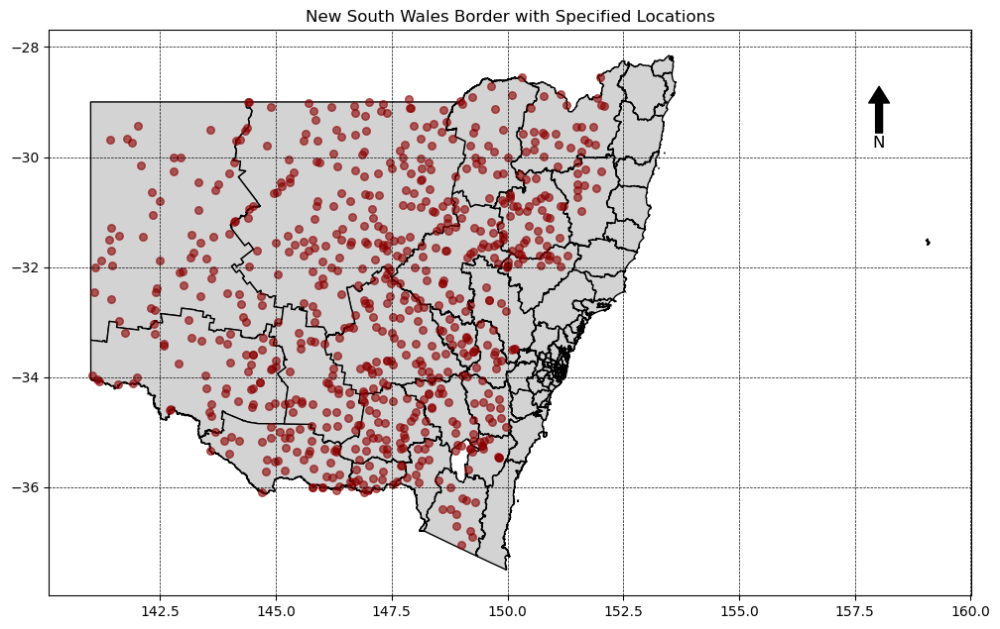

In [24]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Path to the Excel file
excel_path = r'C:\Users\manda\Documents\Master thesis Data\BoM 3 Station list.xlsx'

# Load New South Wales border from the GeoJSON file
nsw_border_gdf = gpd.read_file(r'C:\Users\manda\Downloads\NSW_SA3 (1).json')

# Read the Excel file
station_df = pd.read_excel(excel_path,sheet_name='Sheet 2')

# Clean latitude and longitude columns
station_df['Lat'] = station_df['Lat'].astype(str).str.replace(r'[^\d.-]', '').astype(float)
station_df['Lon'] = station_df['Lon'].astype(str).str.replace(r'[^\d.-]', '').astype(float)

# Convert the station_df to a GeoDataFrame
station_gdf = gpd.GeoDataFrame(station_df, geometry=gpd.points_from_xy(station_df['Lon'], station_df['Lat']))

# Ensure the CRS of the GeoDataFrame matches the one used by the border GeoDataFrame
station_gdf.set_crs(epsg=4326, inplace=True)
if nsw_border_gdf.crs != station_gdf.crs:
    nsw_border_gdf = nsw_border_gdf.to_crs(station_gdf.crs)

# Plotting
fig, ax = plt.subplots(figsize=(12, 12))

# Plot the NSW border
nsw_border_gdf.plot(ax=ax, color='lightgray', edgecolor='black')

# Plot the points from station_gdf
station_gdf.plot(ax=ax, color='darkred', marker='o', markersize=30, alpha=0.6)

# Add a north arrow
x, y, arrow_length = 0.9, 0.9, 0.1
ax.annotate('N', xy=(x, y), xytext=(x, y-arrow_length),
            arrowprops=dict(facecolor='black', width=5, headwidth=15),
            ha='center', va='center', fontsize=12, xycoords=ax.transAxes)

ax.grid(True, color='black', linestyle='--', linewidth=0.5)
# Set plot title
ax.set_title('New South Wales Border with Specified Locations')

# Show plot
plt.show()


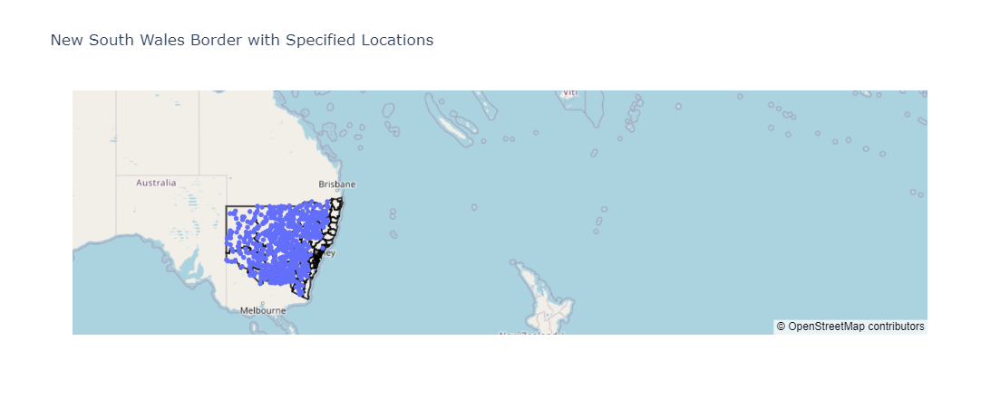

In [1]:
import pandas as pd
import geopandas as gpd
import plotly.express as px

# Load New South Wales border from the GeoJSON file
nsw_border_gdf = gpd.read_file(r'C:\Users\manda\Downloads\NSW_SA3 (1).json')

# Load Excel file
excel_path = r'C:\Users\manda\Documents\Master thesis Data\BoM 3 Station list.xlsx'
stations_df = pd.read_excel(excel_path)

# Assume the Excel has columns 'Station Name', 'Latitude', and 'Longitude'
stations_df.rename(columns={'Latitude': 'Lat', 'Longitude': 'Lon'}, inplace=True)

# Create a scatter plot using Plotly to display all stations
fig = px.scatter_mapbox(stations_df, 
                        lat='Lat', 
                        lon='Lon', 
                        hover_name='Station Name',
                        zoom=5,
                        center={'lat': -32, 'lon': 152},
                        mapbox_style='open-street-map',
                        title="New South Wales Border with Specified Locations")

# Add New South Wales border as a GeoJSON layer
fig.update_layout(mapbox_layers=[
    {
        'below': 'traces',
        'sourcetype': 'geojson',
        'source': nsw_border_gdf.__geo_interface__,
        'type': 'line',
        'color': 'Black',
        'opacity': 0.7
    }
])

# Show plot
fig.show()


In [17]:
import os
import glob
import pandas as pd

# Define the directory and file pattern
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'
file_pattern = os.path.join(directory, '*.txt')

# Get a list of all text files in the directory
text_files = glob.glob(file_pattern)

# Check if there are any text files in the directory
if not text_files:
    print("No text files found in the directory.")
else:
    # Select the first text file for testing
    text_file = text_files[0]
    
    # Create a new Excel writer object
    excel_writer = pd.ExcelWriter(os.path.join(directory, 'combined_data_single_file.xlsx'), engine='openpyxl')

    # Function to extract station number from file name
    def extract_station_number(file_name):
        # Assuming the station number is always 6 digits long
        # Adjust the extraction logic if necessary
        return file_name.split('_')[2] if len(file_name.split('_')) > 2 else file_name[:6]

    # Read the text file into a DataFrame
    df = pd.read_csv(text_file, delimiter=',')
    
    # Get the file name without the directory and extension
    file_name = os.path.basename(text_file).replace('.txt', '')
    
    # Extract the station number to use as sheet name
    sheet_name = extract_station_number(file_name)
    
    # Write the DataFrame to a sheet in the Excel file
    df.to_excel(excel_writer, sheet_name=sheet_name, index=False)

    # Save the Excel file
    excel_writer.save()
    
    print(f"Data from {text_file} has been written to the Excel file 'combined_data_single_file.xlsx' with sheet name '{sheet_name}'.")


AttributeError: 'OpenpyxlWriter' object has no attribute 'save'

In [4]:
import os
import glob
import pandas as pd

# Define the directory and file pattern
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'
file_pattern = os.path.join(directory, '*.txt')

# Get a list of all text files in the directory
text_files = glob.glob(file_pattern)

# Function to extract station number from file name
def extract_station_number(file_name):
    # Assuming the station number is always 6 digits long
    # Adjust the extraction logic if necessary
    parts = file_name.split('_')
    return parts[2] if len(parts) > 2 else file_name[:6]

# Check if there are any text files in the directory
if not text_files:
    print("No text files found in the directory.")
else:
    # Loop through each text file
    for text_file in text_files:
        try:
            # Create a new CSV file for each station
            # Read the text file into a DataFrame
            df = pd.read_csv(text_file, delimiter=',', encoding='utf-8')

            # Get the file name without the directory and extension
            file_name = os.path.basename(text_file).replace('.txt', '')

            # Extract the station number to use as CSV file name
            station_number = extract_station_number(file_name)

            # Define the CSV file path
            csv_file_path = os.path.join(directory, f'{station_number}.csv')

            # Write the DataFrame to a CSV file
            df.to_csv(csv_file_path, index=False)

            print(f"Data from {text_file} has been written to the CSV file '{station_number}.csv'.")
        except UnicodeDecodeError:
            print(f"Error decoding {text_file}. Trying another encoding.")
            continue
        except pd.errors.ParserError as e:
            print(f"Error parsing data from file: {text_file}")
            print(f"Error details: {e}")
            continue

print("All data has been processed and saved into separate CSV files.")


Data from C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_041013_9999999910556653.txt has been written to the CSV file '041013.csv'.
Data from C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_041022_9999999910556653.txt has been written to the CSV file '041022.csv'.
Data from C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_041034_9999999910556653.txt has been written to the CSV file '041034.csv'.
Data from C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_041035_9999999910556653.txt has been written to the CSV file '041035.csv'.
Data from C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_041038_9999999910556653.txt has been written to the CSV file '041038.csv'.
Data from C:\Users\R

Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_070037_9999999910556653.txt has been written to the CSV file '070037.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_070042_9999999910556653.txt has been written to the CSV file '070042.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_070043_9999999910556653.txt has been written to the CSV file '070043.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_070050_9999999910556653.txt has been written to the CSV file '070050.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_070055_9999999910556653.txt has been written to the CSV file '070055.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_0

Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_072151_9999999910556653.txt has been written to the CSV file '072151.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_072155_9999999910556653.txt has been written to the CSV file '072155.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_073000_9999999910556653.txt has been written to the CSV file '073000.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_073003_9999999910556653.txt has been written to the CSV file '073003.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_073009_9999999910556653.txt has been written to the CSV file '073009.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_0

Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074034_9999999910556653.txt has been written to the CSV file '074034.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074035_9999999910556653.txt has been written to the CSV file '074035.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074040_9999999910556653.txt has been written to the CSV file '074040.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074047_9999999910556653.txt has been written to the CSV file '074047.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074049_9999999910556653.txt has been written to the CSV file '074049.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_0

Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074186_9999999910556653.txt has been written to the CSV file '074186.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074198_9999999910556653.txt has been written to the CSV file '074198.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074222_9999999910556653.txt has been written to the CSV file '074222.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_074227_9999999910556653.txt has been written to the CSV file '074227.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075001_9999999910556653.txt has been written to the CSV file '075001.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_0

Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075127_9999999910556653.txt has been written to the CSV file '075127.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075135_9999999910556653.txt has been written to the CSV file '075135.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075152_9999999910556653.txt has been written to the CSV file '075152.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075156_9999999910556653.txt has been written to the CSV file '075156.csv'.
Data from C:\Users\manda\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\DC02D_Data_075157_9999999910556653.txt has been written to the CSV file '075157.csv'.


ParserError: Error tokenizing data. C error: Expected 1 fields in line 9, saw 3


In [13]:
import os
import glob
import pandas as pd

# Define the directory and file pattern
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'
file_pattern = os.path.join(directory, '*.csv')

# Get a list of all CSV files in the directory
csv_files = glob.glob(file_pattern)

# New column name

new_column_name1='Quality'
new_column_name2='Rain_days_accu'
new_column_name3= 'Accumulation'

# Function to rename the specified column in a DataFrame
def rename_column(df):
    columns_to_rename = ['Quality of precipitation value', 'Number of days of rain within the days of accumulation', 'Accumulated number of days over which the precipitation was measured']
    if any(col in df.columns for col in columns_to_rename):
        df.rename(columns={'Quality of precipitation value': new_column_name1, 'Number of days of rain within the days of accumulation': new_column_name2, 'Accumulated number of days over which the precipitation was measured': new_column_name3}, inplace=True)
        return True
    return False


# Check if there are any CSV files in the directory
if not csv_files:
    print("No CSV files found in the directory.")
else:
    # Loop through each CSV file
    for csv_file in csv_files:
        # Read the CSV file into a DataFrame
        df = pd.read_csv(csv_file)

        # Rename the specified column
        if rename_column(df):
            # Define the CSV file path
            csv_file_path = os.path.join(directory, os.path.basename(csv_file))

            # Write the DataFrame back to the CSV file with the updated column name
            df.to_csv(csv_file_path, index=False)

            # Print statement indicating the column has been renamed with the file name
            print(f"Column renamed with the file name in '{csv_file_path}'.")
        else:
            print(f"Column not found in '{csv_file}'. Skipping.")

print("All CSV files have been processed.")


Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041013.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041022.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041034.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041035.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041038.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041047.csv'.
Column renamed with the file name in 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis 

In [6]:
import pandas as pd
import os

# Directory containing CSV files
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'

# List all CSV files in the directory
csv_files = [file for file in os.listdir(directory) if file.endswith('.csv')]

for csv_file in csv_files:
    # Read the CSV file into a DataFrame
    file_path = os.path.join(directory, csv_file)
    data = pd.read_csv(file_path)
    
    # Convert "Number of days of rain within the days of accumulation" column to numeric type
    data['Number of days of rain within the days of accumulation'] = pd.to_numeric(data['Number of days of rain within the days of accumulation'], errors='coerce')
    
    # Check if "Number of days of rain within the days of accumulation" > 1 and change Rainfall accordingly
    data.loc[data['Number of days of rain within the days of accumulation'] > 1, 'Rainfall'] = -99.9
    
    # Save the modified DataFrame back to the same CSV file
    data.to_csv(file_path, index=False)
    print(f"Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: {csv_file}")


Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041013.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041022.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041034.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041035.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041038.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041047.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041056.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 041063.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048076.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048078.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048079.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048081.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048082.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048086.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048091.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 048092.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049058.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049060.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049071.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049072.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049074.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049075.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049076.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 049079.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051015.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051018.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051019.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051020.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051022.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051025.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051029.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 051031.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053055.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053060.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053061.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053088.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053092.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053093.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 053106.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 054003.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056011.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056016.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056017.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056026.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056028.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056029.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056031.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 056032.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061046.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061051.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061053.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061054.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061055.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061064.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061069.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 061070.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 063272.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 063279.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064001.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064007.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064008.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064013.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064015.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 064021.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 068135.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 068137.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 068140.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 068142.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 068207.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 069002.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 069003.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 069010.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072043.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072044.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072049.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072051.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072065.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072067.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072069.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 072070.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074074.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074075.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074080.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074082.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074086.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074088.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074089.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 074092.csv
Changed 'Rainfall' value

Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075060.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075063.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075064.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075065.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075067.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075069.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075074.csv
Changed 'Rainfall' values for rows where 'Number of days of rain within the days of accumulation' > 1 in file: 075075.csv
Changed 'Rainfall' value

In [10]:
import os
import glob
import pandas as pd

# Define the directory and file pattern
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'
file_pattern = os.path.join(directory, '*.csv')

# Get a list of all CSV files in the directory
csv_files = glob.glob(file_pattern)

# New column name for rolling sum of 3 days
new_column_name = 'R3'

# Function to calculate rolling sum of 3 days and add a new column to the DataFrame
def calculate_rolling_sum(df):
    if 'Rainfall' in df.columns:
        # Replace blank and -99.99 values with NaN
        df['Rainfall'] = pd.to_numeric(df['Rainfall'], errors='coerce')
        # Calculate rolling sum of 3 days only if all rainfall values for present day and previous 2 days are available
        valid_rolling_sum = df['Rainfall'].fillna(-99.99).rolling(window=3, min_periods=1).sum()
        df[new_column_name] = valid_rolling_sum.where(valid_rolling_sum >= 0, '')
        return True
    return False

# Check if there are any CSV files in the directory
if not csv_files:
    print("No CSV files found in the directory.")
else:
    # Loop through each CSV file
    for csv_file in csv_files:
        # Read the CSV file into a DataFrame
        df = pd.read_csv(csv_file)

        # Calculate rolling sum of 3 days and add a new column
        if calculate_rolling_sum(df):
            # Define the CSV file path
            csv_file_path = os.path.join(directory, os.path.basename(csv_file))

            # Write the DataFrame back to the CSV file with the new column
            df.to_csv(csv_file_path, index=False)

            # Print statement indicating the rolling sum of 3 days has been calculated with the file name
            print(f"Rolling sum of 3 days calculated and added to '{csv_file_path}' as '{new_column_name}'.")
        else:
            print(f"Column 'Rainfall' not found in '{csv_file}'. Skipping.")

print("All CSV files have been processed.")



Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041013.csv' as 'R3'.
Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041022.csv' as 'R3'.
Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041034.csv' as 'R3'.
Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041035.csv' as 'R3'.
Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041038.csv' as 'R3'.
Rolling sum of 3 days calculated and added to 'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041047.csv' a

In [2]:
import os
import glob
import dask.dataframe as dd

# Load the Excel file
file_path = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx'
sheet_name = 'Sheet1'


# Load the data from the Excel file
stations_df = dd.read_excel(file_path, sheet_name=sheet_name,chunksize=900)

print(stations_df)


AttributeError: module 'dask.dataframe' has no attribute 'read_excel'

In [5]:
import os
import glob
import pandas as pd
import dask.dataframe as dd

# Load the Excel file using pandas
file_path = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx'
sheet_name = 'Sheet1'

# Load the data from the Excel file using pandas
stations_df = pd.read_excel(file_path, sheet_name=sheet_name)

# Convert the pandas DataFrame to a Dask DataFrame
stations_ddf = dd.from_pandas(stations_df,chunksize=900)


print(stations_ddf.head())


  Record identifier  Bureau of Meteorology Station Number  \
0                st                                 40014   
1                st                                 40160   
2                st                                 41001   
3                st                                 41013   
4                st                                 41022   

   Rainfall district code                              Station Name  \
0                      40  BEAUDESERT CRYNA                           
1                      40  NERANG GILSTON RD                          
2                      41  ALLORA POST OFFICE                         
3                      41  CANNING DOWNS                              
4                      41  DALVEEN                                    

  Month/Year site opened. (MM/YYYY) Month/Year site closed. (MM/YYYY)  \
0                           01/1887               2014-02-01 00:00:00   
1                           01/1887               2016-06-01

In [8]:
import os
import pandas as pd
import dask.dataframe as dd
from dask import delayed, compute
from dask.distributed import Client

# Initialize the Dask client
client = Client()
Client()

# Load the Excel file using pandas
file_path = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx'
sheet_name = 'Sheet1'

# Load the data from the Excel file using pandas
stations_df = pd.read_excel(file_path, sheet_name=sheet_name)

# Convert the pandas DataFrame to a Dask DataFrame
stations_ddf = dd.from_pandas(stations_df, npartitions=stations_df.shape[0] // 900 + 1)

# Define the directory containing the CSV files
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'

# Function to process each CSV file
def process_csv_file(row):
    station_number = row['Bureau of Meteorology Station Number']
    csv_file = os.path.join(directory, f'0{station_number}.csv')
    
    if os.path.exists(csv_file):
        # Read the CSV file into a DataFrame
        df_station = pd.read_csv(csv_file)

        # Ensure the 'Year', 'Month', and 'Day' columns are integers
        df_station['Year'] = df_station['Year'].astype(int)
        df_station['Month'] = df_station['Month'].astype(int)
        df_station['Day'] = df_station['Day'].astype(int)
        
        # Filter rows for dates before or on '1900-12-31'
        df_station = df_station[
            (df_station['Year'] < 1900) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] < 12)) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] == 12) & (df_station['Day'] <= 31))
        ]
        
        # Filter rows where Rainfall exceeds R1_99 value
        filtered_rows = df_station[df_station['Rainfall'] > row['R1_99']]
        
        # Print out rows with column names
        if not filtered_rows.empty:
            print(f"Station Number: {station_number}")
            print(filtered_rows)
            print("\n")
    else:
        print(f"CSV file not found for Station Number: {station_number}.")

# Apply the function to each row in the DataFrame using Dask
tasks = [delayed(process_csv_file)(row) for _, row in stations_df.iterrows()]
compute(*tasks)

print("All CSV files have been processed.")



C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\distributed\node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 60550 instead
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\contextlib.py:144: UserWarning: Creating scratch directories is taking a surprisingly long time. (1.09s) This is often due to running workers on a network file system. Consider specifying a local-directory to point workers to write scratch data to a local disk.
  next(self.gen)
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\site-packages\distributed\node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 60590 instead
  warnings.warn(
C:\Users\RUCHITSANDIP\AppData\Local\anaconda3\Lib\contextlib.py:144: UserWarning: Creating scratch directories is taking a surprisingly long time. (2.05s) This is often due to running workers on 

All CSV files have been processed.


2024-06-01 15:47:44,763 - distributed.scheduler - WARNING - Worker failed to heartbeat within 300 seconds. Closing: <WorkerState 'tcp://127.0.0.1:60312', name: 2, status: running, memory: 0, processing: 0>
2024-06-01 15:47:44,843 - distributed.scheduler - WARNING - Received heartbeat from unregistered worker 'tcp://127.0.0.1:60312'.


In [ ]:
import os
import glob
import pandas as pd
import dask.dataframe as dd

# Load the Excel file using pandas
file_path = r'/home/563/rk9077/.jupyter-root/home/Master_thesis_Data/BoM Station Dataset/Station_list_names.xlsx'
sheet_name = 'Sheet1'

# Load the data from the Excel file using pandas
stations_df = pd.read_excel(file_path, sheet_name=sheet_name)

# Define the directory and file pattern
directory = r'/home/563/rk9077/.jupyter-root/home/Master_thesis_Data/BoM Station Dataset/AshcroftL_AllYears'

file_pattern = os.path.join(directory, '*.csv')

# Iterate through each row in the DataFrame stations_df
for index, row in stations_df.iterrows():
    station_number = row['Bureau of Meteorology Station Number']
    
    # Find the corresponding CSV file in the directory
    csv_file = os.path.join(directory, f'0{station_number}.csv')
    
    # Check if the CSV file exists
    if os.path.exists(csv_file):
        # Read the CSV file into a DataFrame
        df_station = pd.read_csv(csv_file)

        # Ensure the 'Year', 'Month', and 'Day' columns are integers
        df_station['Year'] = df_station['Year'].astype(int)
        df_station['Month'] = df_station['Month'].astype(int)
        df_station['Day'] = df_station['Day'].astype(int)
        
        # Filter rows for dates before or on '1900-12-31'
        df_station = df_station[
            (df_station['Year'] < 1900) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] < 12)) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] == 12) & (df_station['Day'] <= 31))
        ]
        
        
        # Filter rows where Rainfall exceeds R1_99 value
        filtered_rows = df_station[df_station['Rainfall'] > row['R1_99']]
        
        # Print out rows with column names
        if not filtered_rows.empty:
            print(f"Station Number: {station_number}")
            print(filtered_rows)
            print("\n")
    else:
        print(f"CSV file not found for Station Number: {station_number}.")




CSV file not found for Station Number: 40014.
CSV file not found for Station Number: 40160.
CSV file not found for Station Number: 41001.
Station Number: 41013
      dc  Station Number  Year  Month  Day  Rainfall Quality  Rain_days_accu  \
2364  dc           41013  1887      1   21      31.5       Y             1.0   
2365  dc           41013  1887      1   22     144.8       Y             1.0   
2387  dc           41013  1887      2   13      41.9       Y             1.0   
2506  dc           41013  1887      6   12      30.5       Y             1.0   
2538  dc           41013  1887      7   14      37.6       Y             1.0   
...   ..             ...   ...    ...  ...       ...     ...             ...   
7098  dc           41013  1900      1    7      51.6       Y             1.0   
7138  dc           41013  1900      2   16      37.3       Y             1.0   
7139  dc           41013  1900      2   17      28.4       Y             1.0   
7181  dc           41013  1900      3   

In [ ]:
import os
import pandas as pd

# Load the Excel file
file_path = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx'
sheet_name = 'Sheet1'

stations_df = pd.read_excel(file_path, sheet_name=sheet_name,chunksize=chunk_size)

# Define the directory containing the station CSV files
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'

# To store already recorded events
recorded_events = []

def is_recorded_event(event_date, station_number):
    for recorded_event in recorded_events:
        if recorded_event['Station Number'] == station_number and recorded_event['Date'] == event_date:
            return True
    return False

def add_recorded_event(event_date, station_number):
    recorded_events.append({'Station Number': station_number, 'Date': event_date})

# Iterate through each row in the DataFrame stations_df
event_counter = 1
for index, row in stations_df.iterrows():
    station_number = row['Bureau of Meteorology Station Number']
    
    # Find the corresponding CSV file in the directory
    csv_file = os.path.join(directory, f'0{station_number}.csv')
    
    # Check if the CSV file exists
    if os.path.exists(csv_file):
        # Read the CSV file into a DataFrame
        df_station = pd.read_csv(csv_file)
        
        # Ensure the 'Year', 'Month', and 'Day' columns are integers
        df_station['Year'] = df_station['Year'].astype(int)
        df_station['Month'] = df_station['Month'].astype(int)
        df_station['Day'] = df_station['Day'].astype(int)
        
        # Filter rows for dates before or on '1900-12-31'
        df_station = df_station[
            (df_station['Year'] < 1900) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] < 12)) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] == 12) & (df_station['Day'] <= 31))
        ]
        
        # Filter rows where Rainfall exceeds R1_99 value
        significant_events = df_station[df_station['Rainfall'] > row['R1_99']]
        
        for event_index, event_row in significant_events.iterrows():
            event_date = pd.to_datetime(f"{event_row['Year']}-{event_row['Month']:02d}-{event_row['Day']:02d}")
            
            if is_recorded_event(event_date, station_number):
                continue
            
            event_group = []
            event_group.append((station_number, event_date, event_row['Rainfall']))
            add_recorded_event(event_date, station_number)
            
            # Search other stations for the same event
            for other_index, other_row in stations_df.iterrows():
                other_station_number = other_row['Bureau of Meteorology Station Number']
                
                if other_station_number == station_number:
                    continue
                
                other_csv_file = os.path.join(directory, f'0{other_station_number}.csv')
                
                if os.path.exists(other_csv_file):
                    df_other_station = pd.read_csv(other_csv_file)
                    
                    df_other_station['Year'] = df_other_station['Year'].astype(int)
                    df_other_station['Month'] = df_other_station['Month'].astype(int)
                    df_other_station['Day'] = df_other_station['Day'].astype(int)
                    
                    df_other_station['Date'] = pd.to_datetime(df_other_station[['Year', 'Month', 'Day']])
                    
                    # Filter for dates before or on '1900-12-31'
                    df_other_station = df_other_station[df_other_station['Date'] <= '1900-12-31']
                    
                    event_dates = [event_date - pd.Timedelta(days=1), event_date, event_date + pd.Timedelta(days=1)]
                    matching_events = df_other_station[
                        (df_other_station['Date'].isin(event_dates)) & 
                        (df_other_station['Rainfall'] > other_row['R1_99'])
                    ]
                    
                    for match_index, match_row in matching_events.iterrows():
                        match_date = match_row['Date']
                        if not is_recorded_event(match_date, other_station_number):
                            event_group.append((other_station_number, match_date, match_row['Rainfall']))
                            add_recorded_event(match_date, other_station_number)
            
            # Print out the grouped event
            if event_group:
                date_range = f"{(event_date - pd.Timedelta(days=1)).strftime('%Y-%m-%d')} to {(event_date + pd.Timedelta(days=1)).strftime('%Y-%m-%d')}"
                print(f"Event {event_counter} - {date_range}")
                for event in event_group:
                    print(f"Station Number: {event[0]}, Date: {event[1].strftime('%Y-%m-%d')}, Rainfall: {event[2]}")
                print("\n")
                event_counter += 1
    else:
        print(f"CSV file not found for Station Number: {station_number}.")


In [ ]:
import os
import pandas as pd
from concurrent.futures import ThreadPoolExecutor, as_completed

# Load the Excel file
file_path = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\Station_list_names.xlsx'
sheet_name = 'Sheet1'
stations_df = pd.read_excel(file_path, sheet_name=sheet_name)

# Define the directory containing the station CSV files
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'

# To store already recorded events
recorded_events = []

def is_recorded_event(event_date, station_number):
    for recorded_event in recorded_events:
        if recorded_event['Station Number'] == station_number and recorded_event['Date'] == event_date:
            return True
    return False

def add_recorded_event(event_date, station_number):
    recorded_events.append({'Station Number': station_number, 'Date': event_date})

# Event counter
event_counter = 1

def process_station(row):
    global event_counter
    station_number = row['Bureau of Meteorology Station Number']
    
    # Find the corresponding CSV file in the directory
    csv_file = os.path.join(directory, f'0{station_number}.csv')
    
    # Check if the CSV file exists
    if os.path.exists(csv_file):
        # Read the CSV file into a DataFrame
        df_station = pd.read_csv(csv_file)
        
        # Ensure the 'Year', 'Month', and 'Day' columns are integers
        df_station['Year'] = df_station['Year'].astype(int)
        df_station['Month'] = df_station['Month'].astype(int)
        df_station['Day'] = df_station['Day'].astype(int)
        
        # Filter rows for dates before or on '1900-12-31'
        df_station = df_station[
            (df_station['Year'] < 1900) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] < 12)) | 
            ((df_station['Year'] == 1900) & (df_station['Month'] == 12) & (df_station['Day'] <= 31))
        ]
        
        # Filter rows where Rainfall exceeds R1_99 value
        significant_events = df_station[df_station['Rainfall'] > row['R1_99']]
        
        for event_index, event_row in significant_events.iterrows():
            event_date = pd.to_datetime(f"{event_row['Year']}-{event_row['Month']:02d}-{event_row['Day']:02d}")
            
            if is_recorded_event(event_date, station_number):
                continue
            
            event_group = []
            event_group.append((station_number, event_date, event_row['Rainfall']))
            add_recorded_event(event_date, station_number)
            
            # Search other stations for the same event
            for other_index, other_row in stations_df.iterrows():
                other_station_number = other_row['Bureau of Meteorology Station Number']
                
                if other_station_number == station_number:
                    continue
                
                other_csv_file = os.path.join(directory, f'0{other_station_number}.csv')
                
                if os.path.exists(other_csv_file):
                    df_other_station = pd.read_csv(other_csv_file)
                    
                    df_other_station['Year'] = df_other_station['Year'].astype(int)
                    df_other_station['Month'] = df_other_station['Month'].astype(int)
                    df_other_station['Day'] = df_other_station['Day'].astype(int)
                    
                    df_other_station['Date'] = pd.to_datetime(df_other_station[['Year', 'Month', 'Day']])
                    
                    # Filter for dates before or on '1900-12-31'
                    df_other_station = df_other_station[df_other_station['Date'] <= '1900-12-31']
                    
                    event_dates = [event_date - pd.Timedelta(days=1), event_date, event_date + pd.Timedelta(days=1)]
                    matching_events = df_other_station[
                        (df_other_station['Date'].isin(event_dates)) & 
                        (df_other_station['Rainfall'] > other_row['R1_99'])
                    ]
                    
                    for match_index, match_row in matching_events.iterrows():
                        match_date = match_row['Date']
                        if not is_recorded_event(match_date, other_station_number):
                            event_group.append((other_station_number, match_date, match_row['Rainfall']))
                            add_recorded_event(match_date, other_station_number)
            
            # Print out the grouped event
            if event_group:
                date_range = f"{(event_date - pd.Timedelta(days=1)).strftime('%Y-%m-%d')} to {(event_date + pd.Timedelta(days=1)).strftime('%Y-%m-%d')}"
                print(f"Event {event_counter} - {date_range}")
                for event in event_group:
                    print(f"Station Number: {event[0]}, Date: {event[1].strftime('%Y-%m-%d')}, Rainfall: {event[2]}")
                print("\n")
                event_counter += 1
    else:
        print(f"CSV file not found for Station Number: {station_number}.")

# Use ThreadPoolExecutor to process up to 100 stations concurrently
with ThreadPoolExecutor(max_workers=100) as executor:
    futures = [executor.submit(process_station, row) for index, row in stations_df.iterrows()]
    for future in as_completed(futures):
        future.result()  # Ensure exceptions are raised if any


CSV file not found for Station Number: 40014.
CSV file not found for Station Number: 40160.
CSV file not found for Station Number: 41001.


In [1]:
import os
import glob

# Define the directory and the file pattern
directory = r'C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears'
file_pattern = os.path.join(directory, '*Copy.csv')

# Get a list of all files in the directory that match the pattern
files_to_delete = glob.glob(file_pattern)

# Check if there are any files to delete
if not files_to_delete:
    print("No files ending with 'Copy.csv' found in the directory.")
else:
    # Loop through each file and delete it
    for file_path in files_to_delete:
        try:
            os.remove(file_path)
            print(f"Deleted file: {file_path}")
        except Exception as e:
            print(f"Error deleting file {file_path}: {e}")

print("All specified files have been processed.")


Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041013 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041022 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041034 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041035 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041038 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041047 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\BoM Station Dataset\AshcroftL_AllYears\041056 - Copy.csv
Deleted file: C:\Users\RUCHITSANDIP\Documents\Documents\Master thesis Data\B

In [15]:
import pandas as pd

# Path to the Excel file
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'

# Read the Excel file
df = pd.read_excel(excel_file)

# Remove empty rows in the "Event" column
df = df.dropna(subset=['Event'])

# Save the modified DataFrame back to the Excel file
df.to_excel(excel_file, index=False)

print("Empty rows between event names have been removed.")


Empty rows between event names have been removed.


In [10]:
import pandas as pd
import re

# Path to the Excel file
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'

# Read the Excel file
df = pd.read_excel(excel_file)

# Remove empty rows in the "Event" column
df = df.dropna(subset=['Event'])

# Function to extract the start date from the event text
def extract_start_date(event_text):
    pattern = r'\d{4}-\d{2}-\d{2}'
    match = re.search(pattern, event_text)
    if match:
        return pd.to_datetime(match.group())
    return pd.NaT

# Extract start dates and add them as a new column
df['Start Date'] = df['Event'].apply(extract_start_date)

# Sort the DataFrame by the start date
df = df.sort_values(by='Start Date')

# Drop the 'Start Date' column as it is no longer needed
df = df.drop(columns=['Start Date'])

# Save the sorted DataFrame back to the Excel file
df.to_excel(excel_file, index=False)

print("Events have been arranged according to their date ranges.")


Events have been arranged according to their date ranges.


In [7]:
import pandas as pd
import re

# Path to the Excel file
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events.xlsx'

# Function to process the sheet
def process_sheet(sheet_name):
    # Read the sheet
    df = pd.read_excel(excel_file, sheet_name=sheet_name)

    # Remove empty rows in the "Event" column
    df = df.dropna(subset=['Event'])

    # Function to extract the start date from the event text
    def extract_start_date(event_text):
        pattern = r'\d{4}-\d{2}-\d{2}'
        match = re.search(pattern, event_text)
        if match:
            return pd.to_datetime(match.group())
        return pd.NaT

    # Extract start dates and add them as a new column
    df['Start Date'] = df['Event'].apply(extract_start_date)

    # Sort the DataFrame by the start date
    df = df.sort_values(by='Start Date')

    # Drop the 'Start Date' column as it is no longer needed
    df = df.drop(columns=['Start Date'])

    return df

# Process both sheets
sheet1 = 'Sheet1'
sheet2 = 'R3_99'
df1 = process_sheet(sheet1)
df2 = process_sheet(sheet2)

# Save the sorted DataFrames back to their respective sheets
with pd.ExcelWriter(excel_file) as writer:
    df1.to_excel(writer, sheet_name=sheet1, index=False)
    df2.to_excel(writer, sheet_name=sheet2, index=False)

print("Events in both sheets have been arranged according to their date ranges.")


Events in both sheets have been arranged according to their date ranges.


Rows with failed year extraction: 0
Empty DataFrame
Columns: [Event, Years]
Index: []
Data type of 'Event' column: object
Year
1901    30
1902    27
1903    39
1904    38
1905    31
        ..
2020    29
2021    32
2022    37
2023    24
2024    11
Name: count, Length: 124, dtype: int64


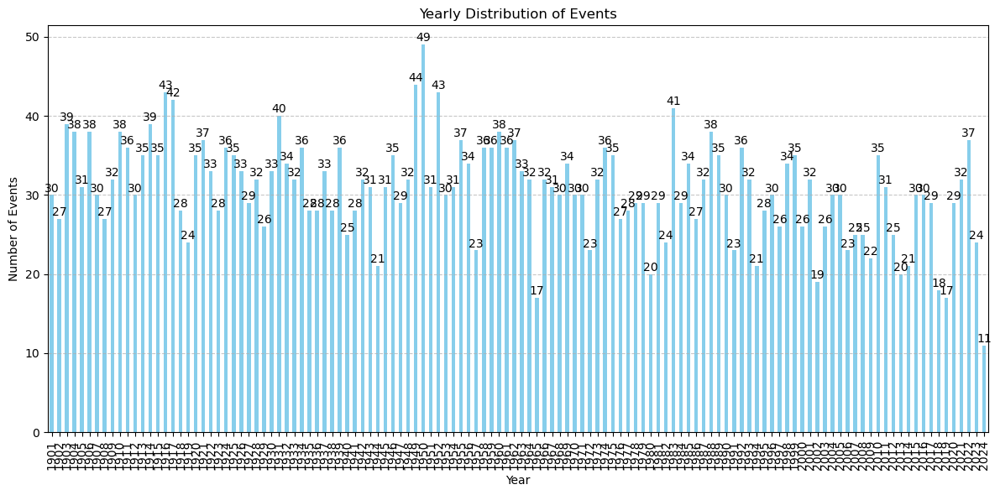

Yearly distribution plot with event counts has been generated and saved successfully.


In [18]:
import pandas as pd
import matplotlib.pyplot as plt
import re

# Path to the Excel file containing event data
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'

# Read the Excel file
event_df = pd.read_excel(excel_file, sheet_name='Sheet1')

# Function to extract the year from an event date range
def extract_years(event_text):
    if pd.isna(event_text):
        return []
    # Remove "Event [number]" from the event text
    event_text = re.sub(r'^Event \d+ - ', '', event_text)
    pattern = r'\b(\d{4})\b'
    years = re.findall(pattern, event_text)
    if len(years) >= 2:
        start_year, end_year = int(years[0]), int(years[-1])
        return list(range(start_year, end_year + 1))
    elif len(years) == 1:
        return [int(years[0])]
    else:
        return []

# Extract the years from each event
event_df['Years'] = event_df['Event'].apply(extract_years)

# Debug: Identify rows where the year extraction failed
failed_extractions = event_df[event_df['Years'].apply(len) == 0]
print(f"Rows with failed year extraction: {len(failed_extractions)}")
print(failed_extractions[['Event', 'Years']].head(20))  # Print the first 20 rows for a sample

# Print all rows with failed extraction to inspect them
for idx, row in failed_extractions.iterrows():
    print(f"Index {idx}: {row['Event']}")

# Check data type of 'Event' column
print(f"Data type of 'Event' column: {event_df['Event'].dtype}")

# Flatten the list of years and create a DataFrame for counting
all_years = [year for sublist in event_df['Years'] for year in sublist]
years_df = pd.DataFrame(all_years, columns=['Year'])

# Count the number of events per year
yearly_counts = years_df['Year'].value_counts().sort_index()

# Debug: Print out the yearly counts to verify correctness
print(yearly_counts)

# Plot the yearly distribution of events
plt.figure(figsize=(12, 6))
bars = yearly_counts.plot(kind='bar', color='skyblue')
plt.title('Yearly Distribution of Events')
plt.xlabel('Year')
plt.ylabel('Number of Events')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Annotate the bars with the event counts
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.1, int(yval), ha='center', va='bottom')

# Save the plot
output_plot = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Yearly_Distribution_of_Events 1901+.png'
plt.savefig(output_plot)
plt.show()

# Save the event count column to the second sheet of the Excel file
with pd.ExcelWriter(excel_file, engine='openpyxl', mode='a') as writer:
    yearly_counts.to_frame(name='Event Count').to_excel(writer, sheet_name='Yearly Event Counts')

print("Yearly distribution plot with event counts has been generated and saved successfully.")


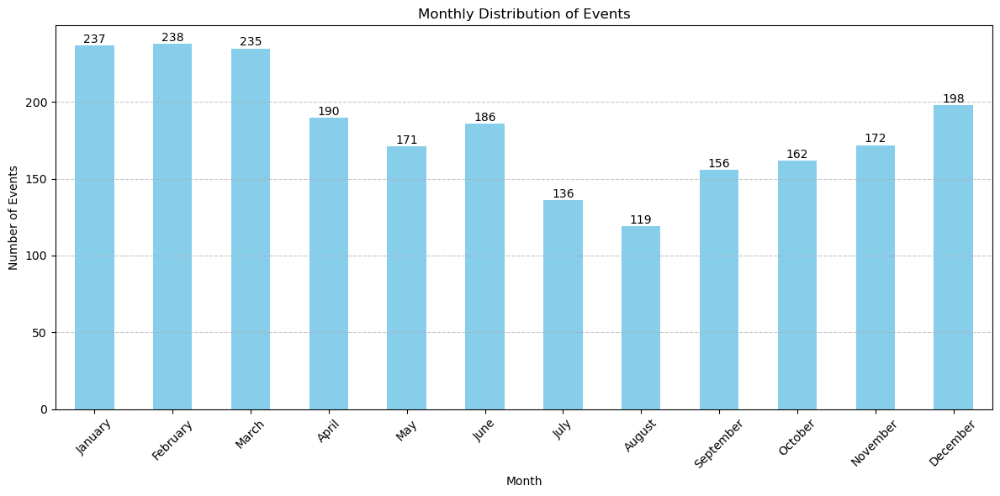

Monthly distribution plot with event counts has been generated and saved successfully.


In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import re

# Path to the Excel file containing event data
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events.xlsx'

# Read the Excel file
event_df = pd.read_excel(excel_file, sheet_name='Sheet1')

# Function to extract months from an event date range
def extract_months(event_text):
    if pd.isna(event_text):
        return []
    pattern = r'\d{4}-(\d{2})-\d{2}'
    dates = re.findall(pattern, event_text)
    return dates

# Extract the months from each event
event_df['Months'] = event_df['Event'].apply(extract_months)

# Flatten the list of months and create a DataFrame for counting
all_months = [month for sublist in event_df['Months'] for month in sublist]
months_df = pd.DataFrame(all_months, columns=['Month'])

# Count the number of events per month
monthly_counts = months_df['Month'].value_counts().sort_index()

# Map numeric months to month names
month_names = {str(i).zfill(2): month for i, month in enumerate(['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'], 1)}
monthly_counts.index = monthly_counts.index.map(month_names)

# Plot the monthly distribution of events
plt.figure(figsize=(12, 6))
bars = monthly_counts.plot(kind='bar', color='skyblue')
plt.title('Monthly Distribution of Events')
plt.xlabel('Month')
plt.ylabel('Number of Events')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)
plt.tight_layout()

# Annotate the bars with the event counts
for bar in bars.patches:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, yval + 0.1, int(yval), ha='center', va='bottom')

# Save the plot
output_plot = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Monthly_Distribution_of_Events.png'
plt.savefig(output_plot)
plt.show()

print("Monthly distribution plot with event counts has been generated and saved successfully.")


In [19]:
import pandas as pd
import re

# Path to the Excel files
event_excel_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'
station_excel_path = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\R1_99_New Events 1901+.xlsx'

# Read the event data
event_df = pd.read_excel(event_excel_path, sheet_name='Sheet1')

# Function to extract the years from text
def extract_years(text):
    if pd.isna(text):
        return []
    pattern = r'\d{4}'
    years = re.findall(pattern, text)
    if len(years) >= 1:
        return list(map(int, years))
    else:
        return []

# Extract the years from each event
event_df['Years'] = event_df['Event'].apply(extract_years)

print("Event Data:")
print(event_df.head())

# Read the station data
station_df = pd.read_excel(station_excel_path)

print("Station Data:")
print(station_df.head())

# Extract years from the Date column in the station data
station_df['Years'] = station_df['Date'].apply(extract_years)

print("Station Data with Years:")
print(station_df.head())

# Flatten the list of years and create a DataFrame for counting
all_years = [year for sublist in station_df['Years'] for year in sublist]
years_df = pd.DataFrame(all_years, columns=['Year'])

print("All Years Extracted from Station Data:")
print(years_df.head())

# Extract unique station numbers using regex
station_df['Station Number'] = station_df['Station Number'].dropna()
station_df['Station Number'] = station_df['Station Number'].apply(lambda x: re.findall(r'\d{5}', str(x))[0] if re.findall(r'\d{5}', str(x)) else None)
station_df = station_df.dropna(subset=['Station Number'])
station_df['Station Number'] = station_df['Station Number'].astype(str)

print("Station Data with Cleaned Station Numbers:")
print(station_df.head())

# Initialize a dictionary to store unique station numbers for each year
year_station_dict = {}

# Iterate over each year and collect unique station numbers
for index, row in station_df.iterrows():
    years = row['Years']
    station_number = row['Station Number']
    for year in years:
        if year not in year_station_dict:
            year_station_dict[year] = set()
        year_station_dict[year].add(station_number)

# Create a DataFrame for the output
output_data = {'Year': [], 'Total Unique Stations': []}
for year, stations in sorted(year_station_dict.items()):
    output_data['Year'].append(year)
    output_data['Total Unique Stations'].append(len(stations))
    print(f"Year: {year}, Total Unique Stations: {len(stations)}")

output_df = pd.DataFrame(output_data)

# Write the output to a new sheet in the event Excel file
with pd.ExcelWriter(event_excel_path, mode='a', engine='openpyxl') as writer:
    output_df.to_excel(writer, sheet_name='Yearly_Station_Counts', index=False)

print(f"Yearly station counts have been written to {event_excel_path} successfully.")


Event Data:
                                Event         Years
0  Event 1 - 1901-03-17 to 1901-03-23  [1901, 1901]
1  Event 2 - 1903-05-04 to 1903-05-10  [1903, 1903]
2  Event 3 - 1903-07-12 to 1903-07-18  [1903, 1903]
3  Event 4 - 1904-03-28 to 1904-04-03  [1904, 1904]
4  Event 5 - 1905-04-01 to 1905-04-07  [1905, 1905]
Station Data:
                                Event         Station Number  \
0  Event 1 - 1901-03-17 to 1901-03-23                    NaN   
1                                 NaN  Station Number: 58142   
2                                 NaN  Station Number: 58056   
3                                 NaN  Station Number: 58013   
4                                 NaN  Station Number: 58042   

               Date         Rainfall  
0               NaN              NaN  
1  Date: 1901-03-20  Rainfall: 178.3  
2  Date: 1901-03-21  Rainfall: 128.0  
3  Date: 1901-03-21  Rainfall: 122.2  
4  Date: 1901-03-21  Rainfall: 160.0  
Station Data with Years:
                  

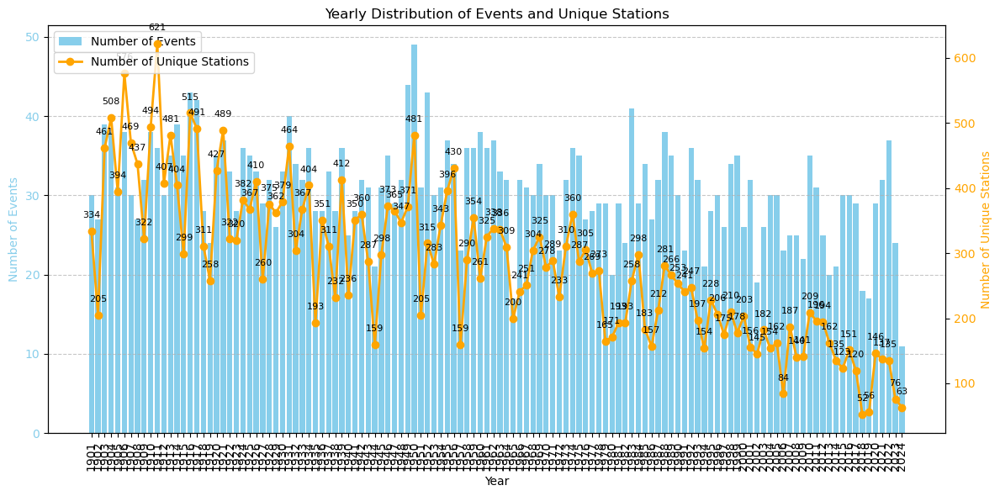

Yearly distribution plot with events and unique stations has been generated and saved successfully.


In [20]:
import pandas as pd
import matplotlib.pyplot as plt

# Path to the Excel files
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'

# Read the 'Yearly_Station_Counts' sheet
station_counts_df = pd.read_excel(excel_file, sheet_name='Yearly_Station_Counts')

# Plotting setup
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plotting the number of events per year
ax1.bar(station_counts_df['Year'], station_counts_df['Event Count'], color='skyblue', label='Number of Events')
ax1.set_xlabel('Year')
ax1.set_ylabel('Number of Events', color='skyblue')
ax1.tick_params(axis='y', labelcolor='skyblue')
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# Creating a second y-axis for number of unique stations
ax2 = ax1.twinx()
ax2.plot(station_counts_df['Year'], station_counts_df['Total Unique Stations'], color='orange', marker='o', linestyle='-', linewidth=2, label='Number of Unique Stations')
ax2.set_ylabel('Number of Unique Stations', color='orange')
ax2.tick_params(axis='y', labelcolor='orange')

# Annotate the line plot with unique station counts
for x, y in zip(station_counts_df['Year'], station_counts_df['Total Unique Stations']):
    ax2.annotate(f'{y}', (x, y), textcoords='offset points', xytext=(0,10), ha='center', va='bottom', fontsize=8, color='black')

# Title and legends
plt.title('Yearly Distribution of Events and Unique Stations')
ax1.legend(loc='upper left',bbox_to_anchor=(0, 1))
ax2.legend(loc='upper left',bbox_to_anchor=(0, 0.95))

# Set x-axis ticks and labels without gaps
ax1.set_xticks(station_counts_df['Year'])
ax1.set_xticklabels(station_counts_df['Year'], rotation='vertical')

# Save the plot
output_plot = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\Yearly_Distribution_of_Events_and_Unique_Stations 1901+.png'
plt.tight_layout()
plt.savefig(output_plot)
plt.show()

print("Yearly distribution plot with events and unique stations has been generated and saved successfully.")


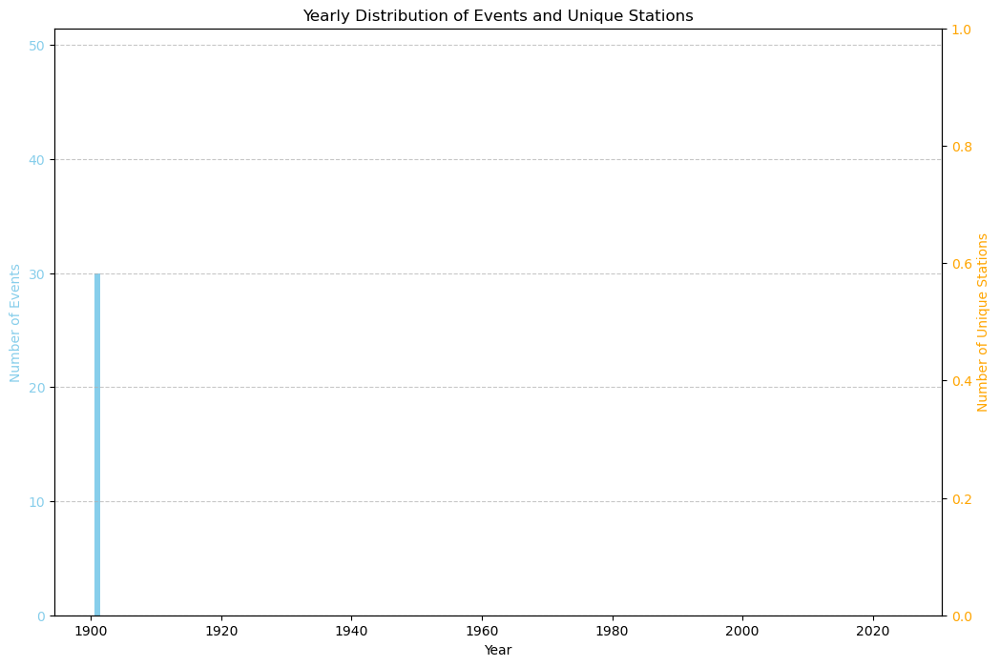

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Path to the Excel file containing event data
excel_file = r'C:\Users\RUCHITSANDIP\OneDrive - The University of Melbourne\Documents\Documents\Master thesis Data\BoM Station Dataset\List of Events 1901+.xlsx'

# Read the 'Yearly_Station_Counts' sheet
station_counts_df = pd.read_excel(excel_file, sheet_name='Yearly_Station_Counts')

# Sort dataframe by year (if not already sorted)
station_counts_df = station_counts_df.sort_values(by='Year')

# Plotting setup
fig, ax = plt.subplots(figsize=(12, 8))

# Initialize empty bar and line plots
bars = ax.bar(station_counts_df['Year'], station_counts_df['Event Count'], color='skyblue', label='Number of Events')
line, = ax.plot([], [], color='orange', marker='o', linestyle='-', linewidth=2, label='Number of Unique Stations')

# Axes labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Number of Events', color='skyblue')
ax.tick_params(axis='y', labelcolor='skyblue')
ax2 = ax.twinx()
ax2.set_ylabel('Number of Unique Stations', color='orange')
ax2.tick_params(axis='y', labelcolor='orange')
ax.grid(axis='y', linestyle='--', alpha=0.7)
plt.title('Yearly Distribution of Events and Unique Stations')

# Animation function to update the plot for each frame
def animate(year):
    # Update data for each frame
    current_data = station_counts_df[station_counts_df['Year'] <= year]
    
    # Update bar heights
    for i, bar in enumerate(bars):
        if i < len(current_data):
            bar.set_height(current_data.iloc[i]['Event Count'])
        else:
            bar.set_height(0)  # Handle case where there are fewer bars in current frame
    
    # Update line plot
    if len(current_data) > 0:
        line.set_data(current_data['Year'], current_data['Total Unique Stations'])
    
    # Annotate the line plot with unique station counts
    for x, y in zip(current_data['Year'], current_data['Total Unique Stations']):
        ax.annotate(f'{y}', (x, y), textcoords='offset points', xytext=(0,10), ha='center', va='bottom', fontsize=8, color='black')
    
    return bars, line

# Animate the plot
anim = FuncAnimation(fig, animate, frames=station_counts_df['Year'], interval=1000, blit=False)

# Display the animation
HTML(anim.to_jshtml())
